### Визуализация данных с Matplotlib и Seaborn

##### Подключение библиотек и скриптов

In [24]:
import numpy as np
import pandas as pd

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns

In [26]:
# Считываем датасет
df = pd.read_csv('bank.csv', sep=',')
df.sample(n=10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,convert,poutcome,deposit
9129,31,technician,single,secondary,no,1170,yes,no,unknown,2,jun,120,2,-1,0,unknown,no
2824,73,retired,married,primary,no,542,no,no,cellular,26,oct,355,1,180,5,failure,yes
1571,33,technician,married,secondary,no,1968,yes,no,cellular,20,apr,1817,3,-1,0,unknown,yes
6034,33,technician,divorced,secondary,no,522,no,yes,cellular,7,jul,559,4,-1,0,unknown,no
713,36,technician,single,secondary,no,651,no,no,cellular,7,aug,876,1,-1,0,unknown,yes
5636,29,services,single,secondary,no,1008,yes,no,unknown,23,may,426,9,-1,0,unknown,no
3166,30,management,married,tertiary,no,1996,no,no,cellular,8,feb,1133,3,101,1,other,yes
11109,31,blue-collar,married,secondary,no,604,yes,no,cellular,18,nov,394,2,-1,0,unknown,no
1738,50,admin.,single,secondary,no,2252,no,no,cellular,30,apr,652,2,-1,0,unknown,yes
3904,34,management,married,tertiary,no,589,no,no,cellular,1,sep,300,1,44,3,other,yes


##### Детали описания графиков
1.	title. Заголовок графика
2.	y label/x label. Именования осей х и у
3.	legend. Легенда к графикам
4.	major/minor ticks. Основной и дополнительный масштаб осей
5.	major/minor grid. Основная и дополнительная сетка на графике

#### Стандартный синтаксис создания графика

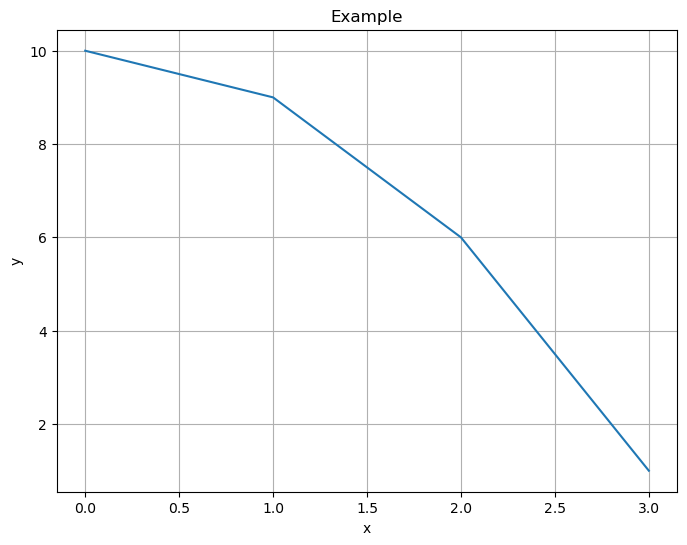

In [27]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();   # сетка

### Виды графиков

#### Линейный график

In [28]:
# Готовим данные для графика в виде сводной таблицы

data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month')
data.head()

,month,count
0,apr,923
1,aug,1519
2,dec,110
3,feb,776
4,jan,344


###### Matplotlib

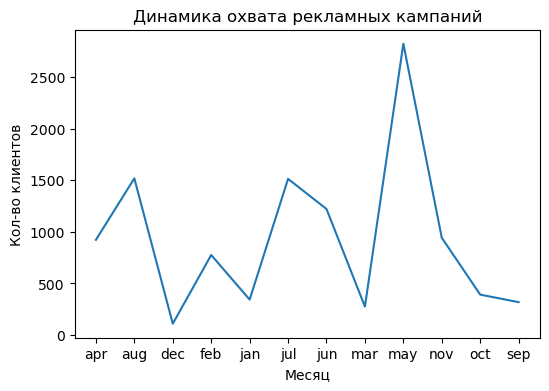

In [29]:
plt.figure(figsize=(6, 4))

plt.plot(data['month'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

###### Seaborn

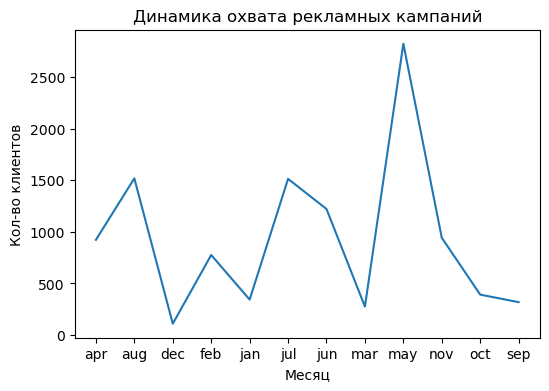

In [30]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['month'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов');

### Гистограмма

##### Matplotlib

Text(0, 0.5, 'Кол-во клиентов')

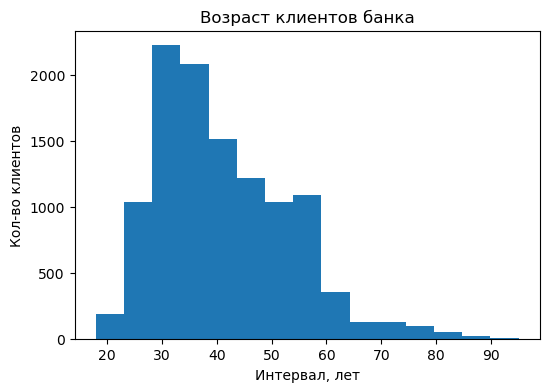

In [31]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов')

###### Seaborn

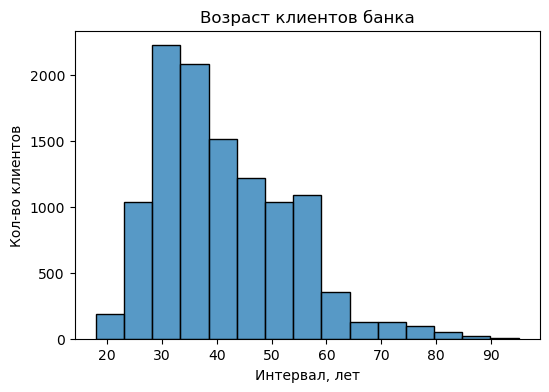

In [32]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

#### Диаграмма рассеяния

In [33]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('age')['convert'].sum().reset_index()
data.head()

,age,convert
0,18,2
1,19,8
2,20,26
3,21,25
4,22,49


###### Matplotlib

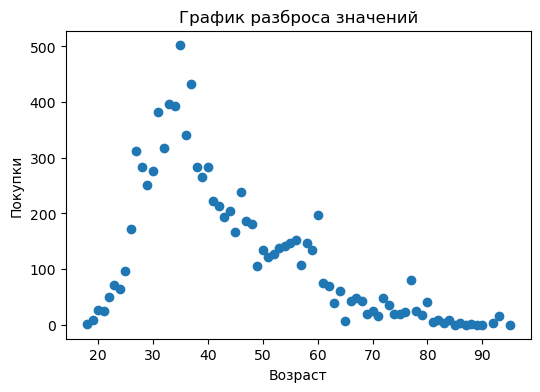

In [34]:
plt.figure(figsize=(6, 4))

plt.scatter(data['age'], data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

###### Seaborn

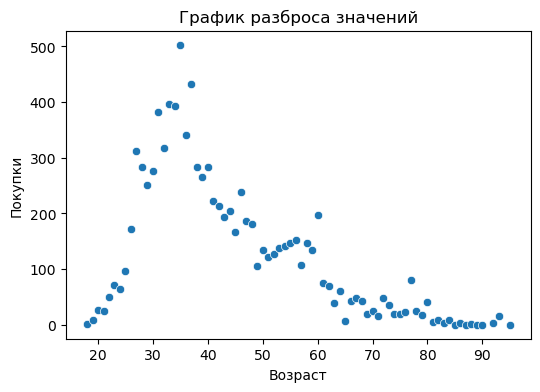

In [35]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['age'], y=data['convert'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Покупки');

#### Столбчатые диаграммы

In [36]:
# Готовим данные для графика
data = df['job'].value_counts().reset_index()
data.head()

,index,job
0,management,2566
1,blue-collar,1944
2,technician,1823
3,admin.,1334
4,services,923


###### Matplotlib

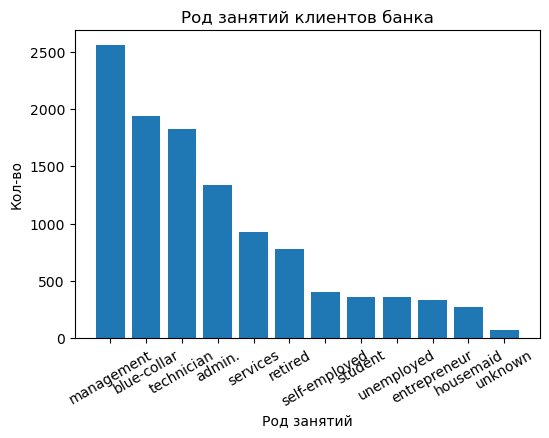

In [37]:
plt.figure(figsize=(6, 4))

plt.bar(data['index'], data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

###### Seaborn

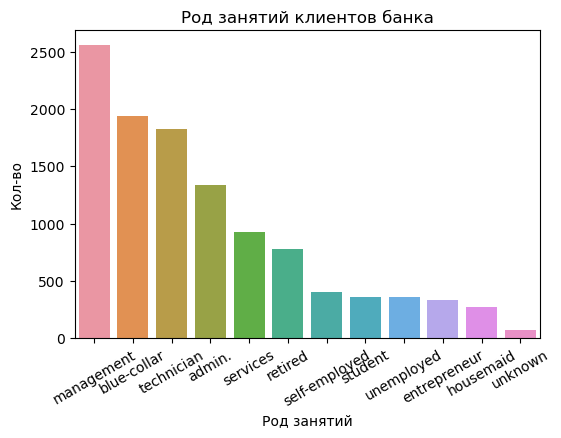

In [38]:
plt.figure(figsize=(6, 4))

sns.barplot(x=data['index'], y=data['job'])

plt.title('Род занятий клиентов банка')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.xticks(rotation=30); # поворот текста в графике

##### Многорядовые столбчатые диаграммы

In [39]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes,2,3,4,5,6,7,8,...,26,27,28,29,30,37,40,41,55,58
4,management,1840,224,165,127,54,41,33,21,17,...,1,0,1,0,0,0,0,0,0,0
1,blue-collar,1573,123,93,56,38,21,8,7,3,...,0,1,0,0,0,0,0,1,0,1
9,technician,1377,135,114,60,32,32,24,15,11,...,0,0,0,0,0,0,1,0,1,0
0,admin.,944,121,100,54,32,23,14,8,10,...,0,1,0,0,0,0,0,0,0,0
7,services,726,66,36,31,25,11,10,4,6,...,0,0,0,0,1,0,0,0,0,0


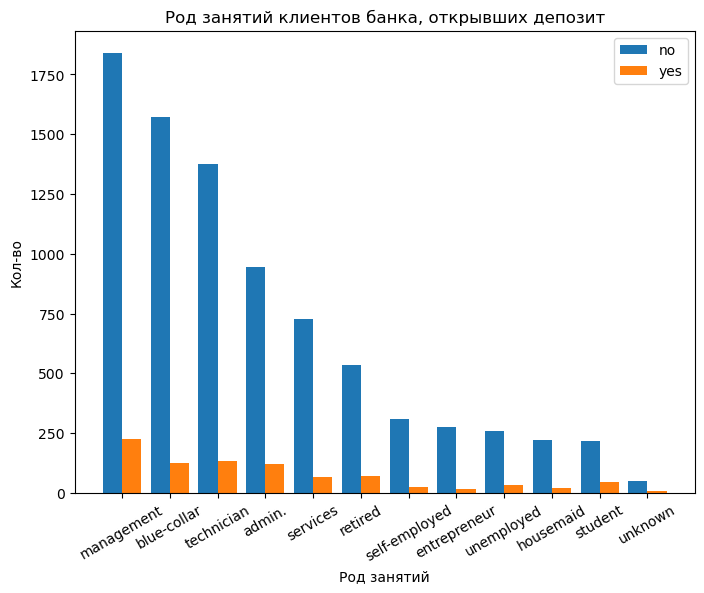

In [40]:
# Строим столбчатую многорядную диаграмму

plt.figure(figsize=(8, 6))

# определяем кол-во делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation = 30);  # добавляем метки делений

##### Сложенная столбчатая диаграмма

In [41]:
# Готовим данные для графика
data = pd.crosstab(df['job'], df['convert'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes,2,3,4,5,6,7,8,...,26,27,28,29,30,37,40,41,55,58
2,entrepreneur,0.838415,0.054878,0.048780,0.009146,0.018293,0.009146,0.003049,0.006098,0.003049,...,0.0,0.000000,0.0,0.003049,0.000000,0.0,0.0,0.000000,0.0,0.000000
3,housemaid,0.810219,0.069343,0.032847,0.040146,0.021898,0.010949,0.003650,0.003650,0.007299,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000
1,blue-collar,0.809156,0.063272,0.047840,0.028807,0.019547,0.010802,0.004115,0.003601,0.001543,...,0.0,0.000514,0.0,0.000000,0.000000,0.0,0.0,0.000514,0.0,0.000514
7,services,0.786566,0.071506,0.039003,0.033586,0.027086,0.011918,0.010834,0.004334,0.006501,...,0.0,0.000000,0.0,0.000000,0.001083,0.0,0.0,0.000000,0.0,0.000000
6,self-employed,0.758025,0.064198,0.066667,0.039506,0.024691,0.014815,0.007407,0.004938,0.002469,...,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000


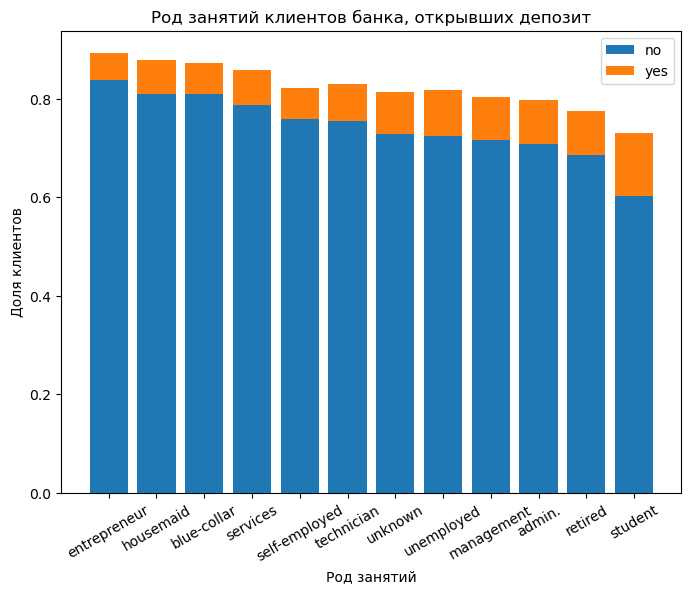

In [42]:
# Строим столбчатую многорядную сложенную диаграмму

plt.figure(figsize=(8, 6))

plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])

plt.title('Род занятий клиентов банка, открывших депозит')
plt.xlabel('Род занятий')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes'])
plt.xticks(rotation = 30);

#### Ящики с усами

In [44]:
# Готовим данные для графика
data1 = df['duration'][df['convert'] == 1]  #  признак разговора с клиентом, конверсия (да) == 1 - депазит открыт
data2 = df['duration'][df['convert'] == 0]    # == 0 -  депазит не был открыт
data1.head()

890     519
951    1091
961     596
982     424
985     522
Name: duration, dtype: int64

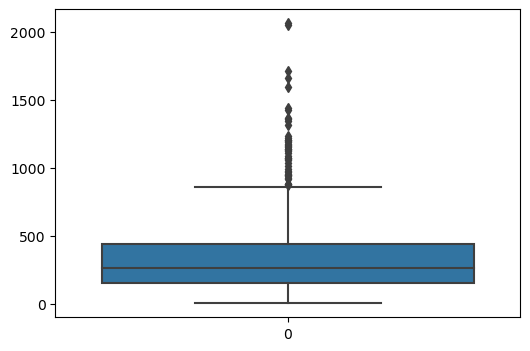

In [45]:
plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1]);

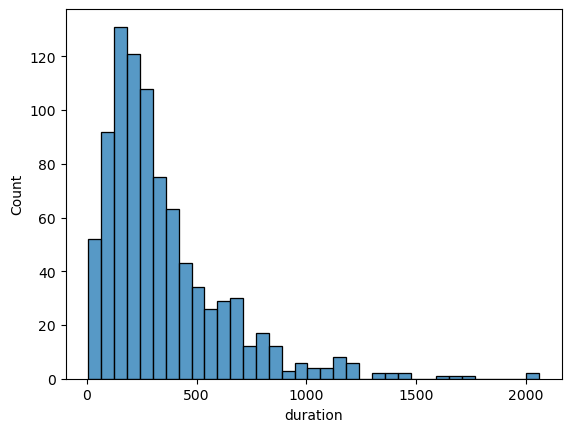

In [46]:
sns.histplot(x=data1);

###### Matplotlib

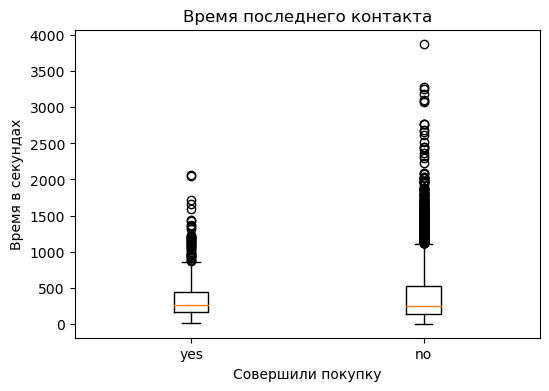

In [47]:
# Строим боксплот

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2])

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')
plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

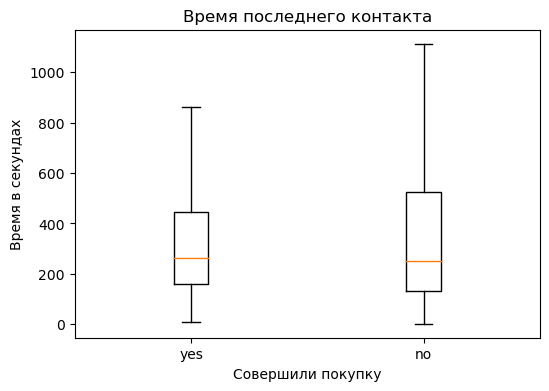

In [48]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

plt.boxplot([data1, data2], showfliers=False)  # showfliers=False - убрать выбросы

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([1, 2], ['yes', 'no']);

###### Seaborn

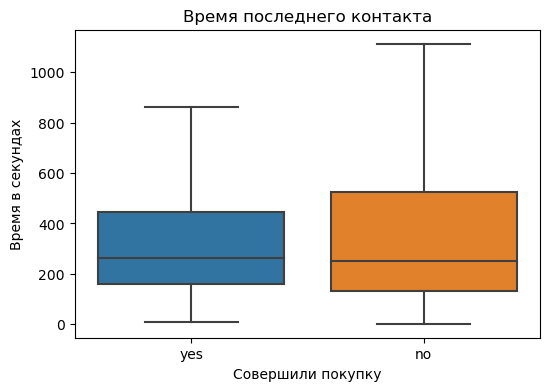

In [49]:
# Строим боксплот без выбросов 

plt.figure(figsize=(6, 4))

sns.boxplot(data=[data1, data2], showfliers=False)

plt.title('Время последнего контакта')
plt.xlabel('Совершили покупку')

plt.ylabel('Время в секундах')
plt.xticks([0, 1], ['yes', 'no']);

#### Круговая диаграмма

In [50]:
# Готовим данные для графика
data = df['convert'].value_counts()
data.index = ['no', 'yes']
data.head()

ValueError: Length mismatch: Expected axis has 34 elements, new values have 2 elements

###### Matplotlib

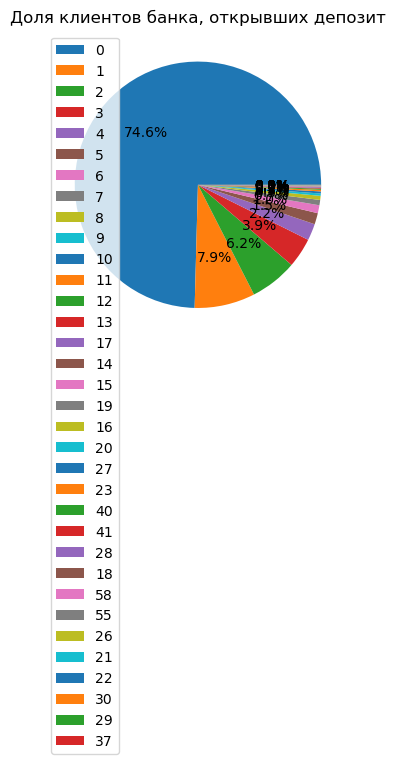

In [51]:
# Строим круговую диаграмму

plt.figure(figsize=(6, 4))

plt.pie(data, autopct='%1.1f%%')

plt.title('Доля клиентов банка, открывших депозит')
plt.legend(data.index);

### Визуальный анализ данных

##### Описание датасета

Статистические данные о ряде домов в Калифорнии, основанные на переписи 1990 года.

- longitude - долгота
- latitude - широта
- housing_median_age - средний возраст дома
- total_rooms - общее количество комнат
- total_bedrooms - общее количество спален
- population - количество проживающих
- households - домохозяйства
- ocean_proximity - близость океана
- median_income - средний доход
- median_house_value - средняя стоимость дома

In [52]:
df = pd.read_csv('housing.csv', sep=',')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


##### Распределение вещественных признаков

In [53]:
# {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
# [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

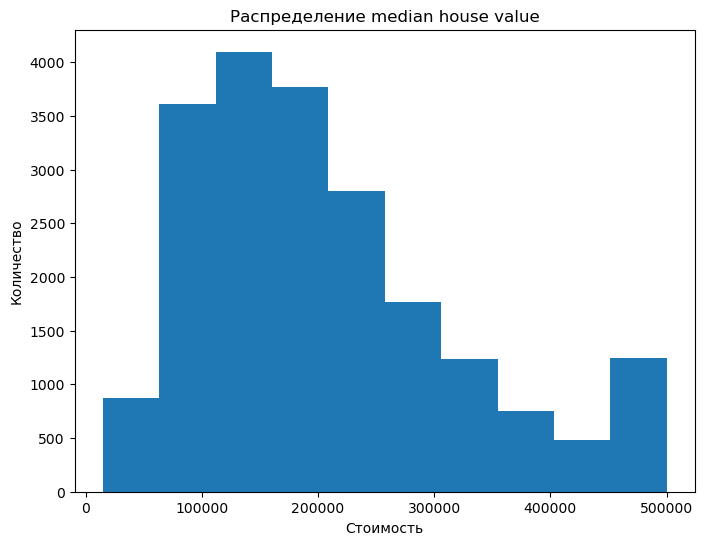

In [54]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [55]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

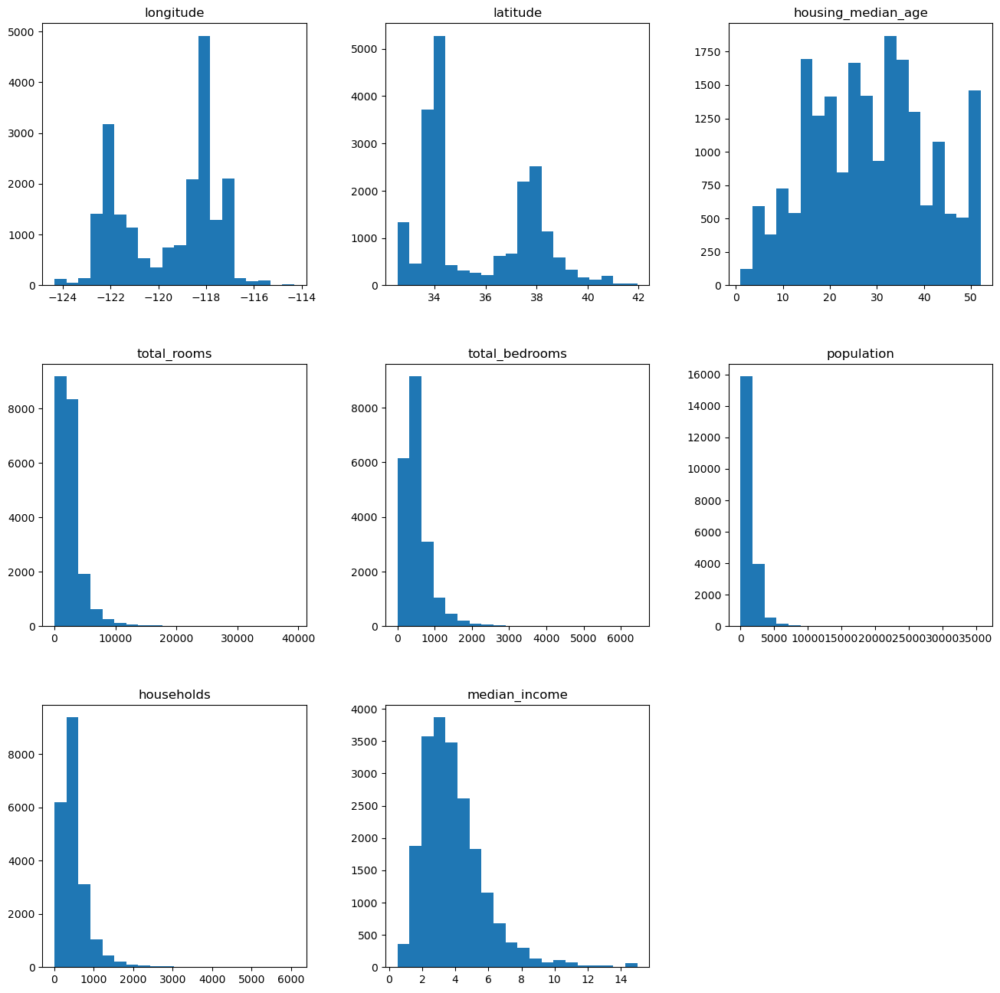

In [56]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

##### Поиск выбросов с помощью box plot

##### Как строится box plot

###### Подробное объяснение

- box - от 25% до 75% квантиля
- линия в середине box - медиана
- "усы"

###### Как строятся "усы" - вариантов масса

- среднее +/- 3 сигма (стандартное отклонение)
- min / max
- median +/- 1.5*(q75 - q25),
- ...

*Интерквартильный размах = q75 - q25

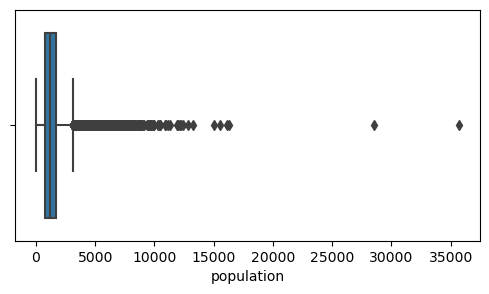

In [57]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df['population'], whis=1.5)

plt.xlabel('population')
plt.show()

### Анализ категориальных признаков

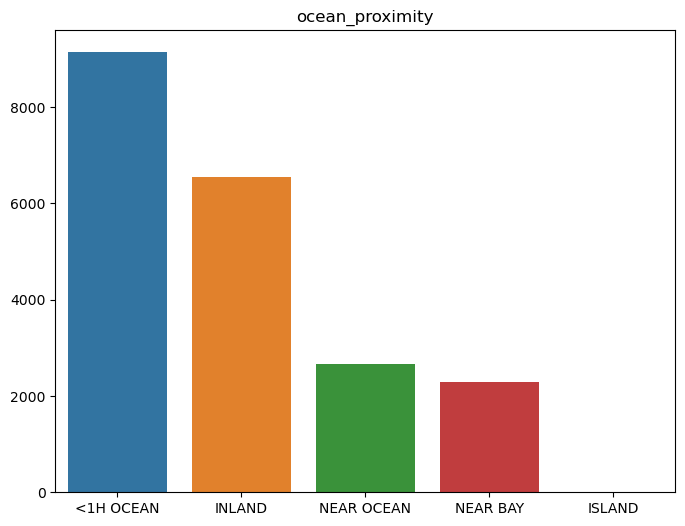

In [58]:
counts = df['ocean_proximity'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

In [59]:
counts = df['INLAND'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('INLAND')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

KeyError: 'INLAND'

### Анализ взаимных распределений

median_income' - средний зароботок семейств,    median_house_value - средняя стоимость недвижимости в которой они проживают

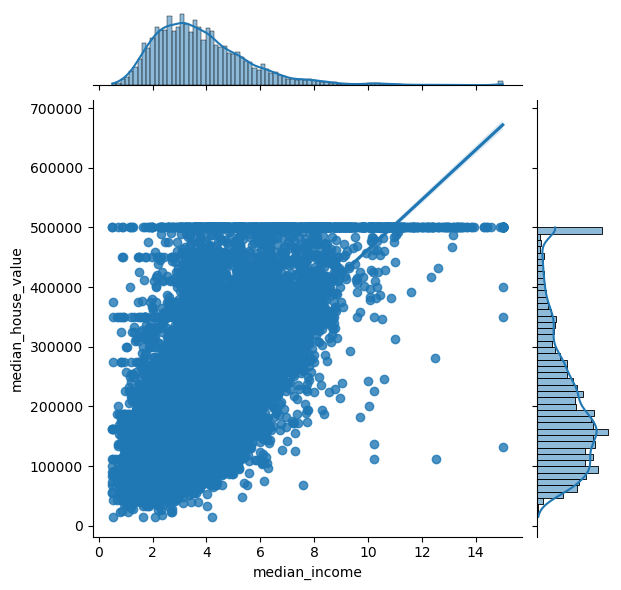

In [60]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

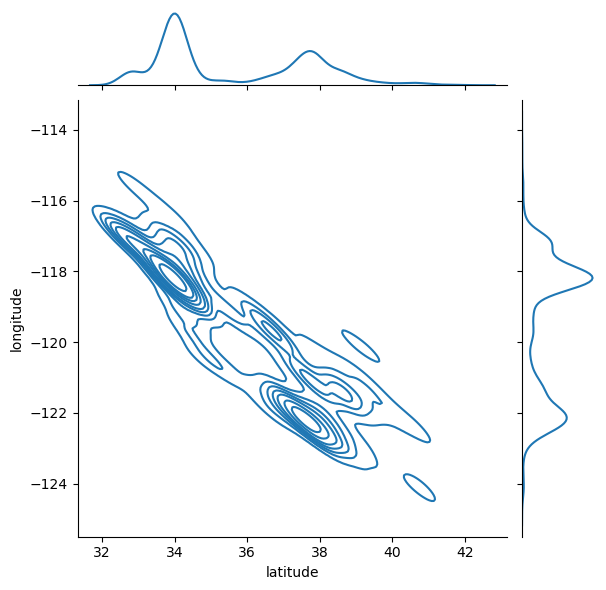

In [61]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

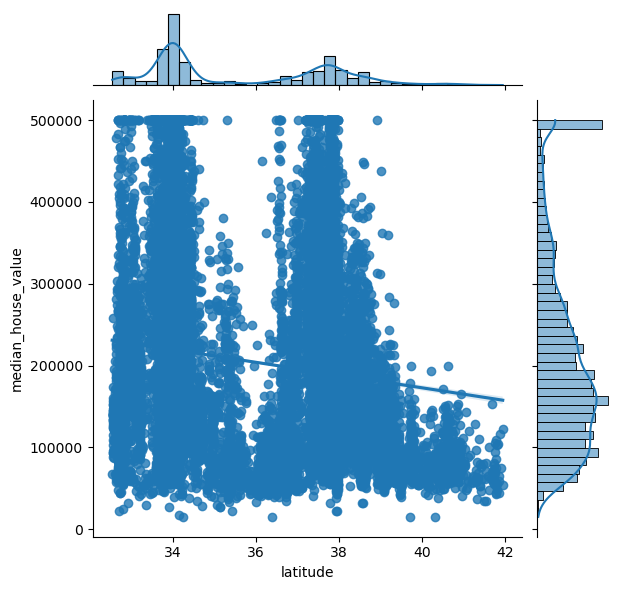

In [62]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

###### Видно два города, имеет смысл посмотреть на зависимость по отдельности

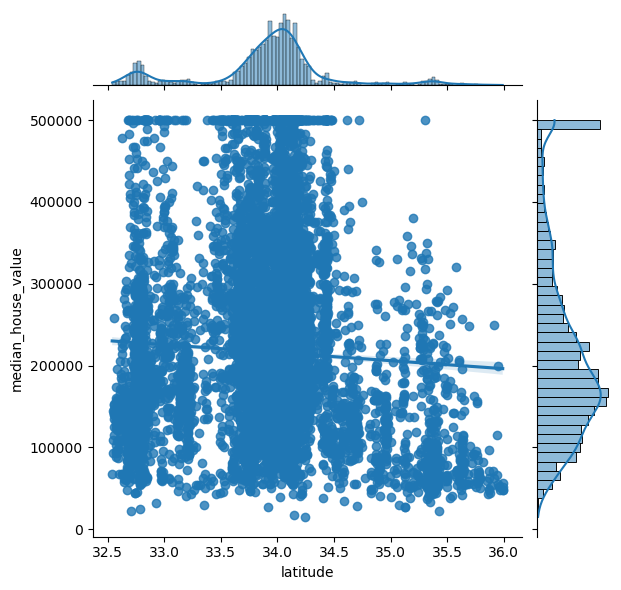

In [63]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

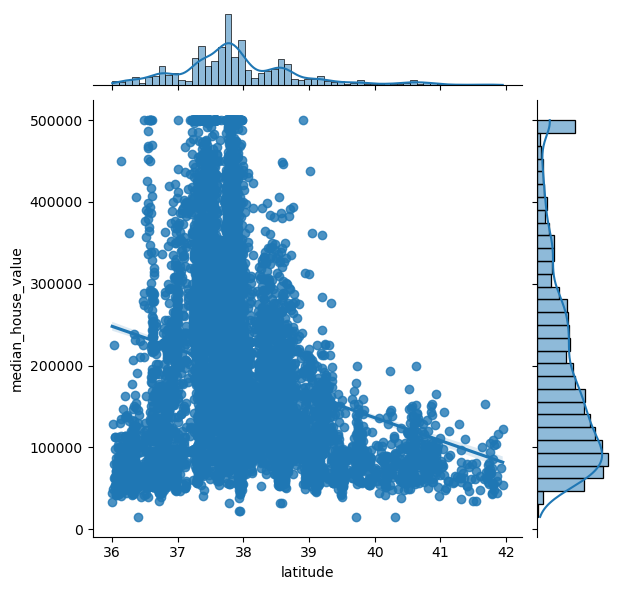

In [64]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

###### longitude

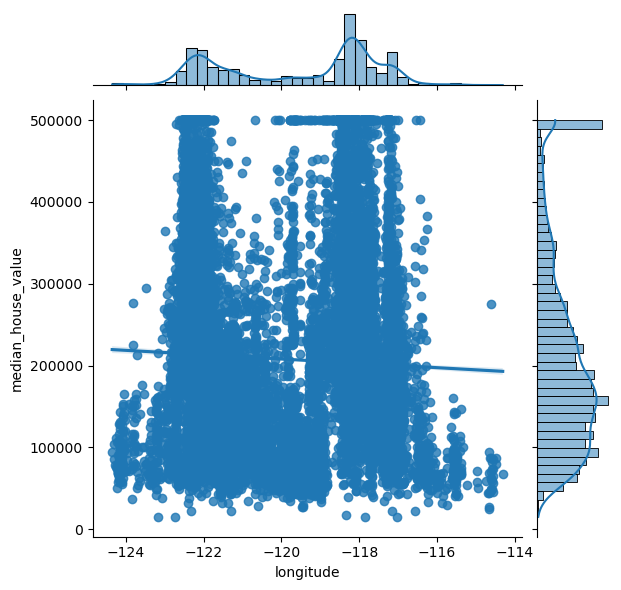

In [65]:
sns.jointplot(x=df['longitude'], y=df['median_house_value'], kind='reg');

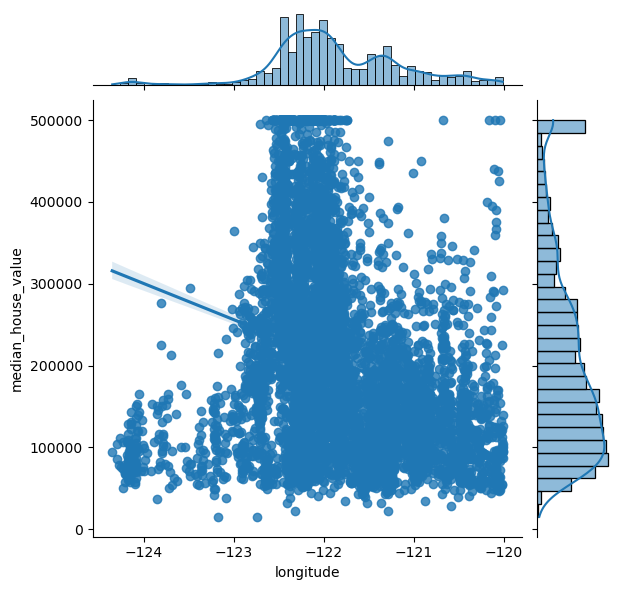

In [66]:
df_cut = df[df['longitude'] < -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

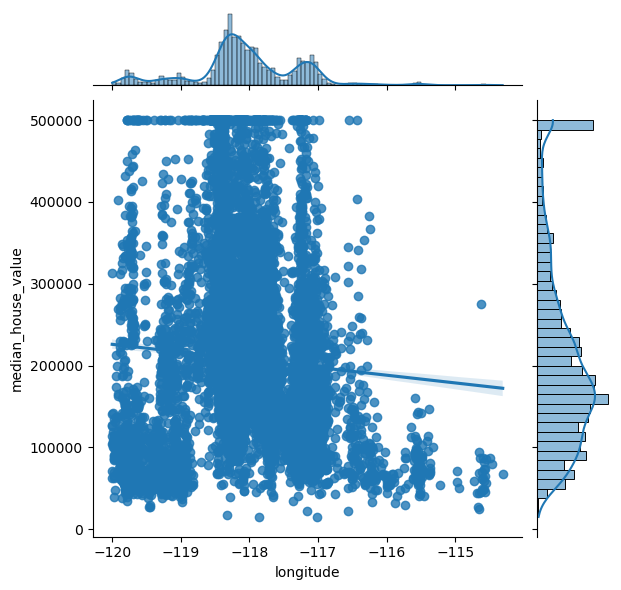

In [67]:
df_cut = df[df['longitude'] >= -120]
sns.jointplot(x=df_cut['longitude'], y=df_cut['median_house_value'], kind='reg');

##### Категориальные / бинарные признаки

#### box plot

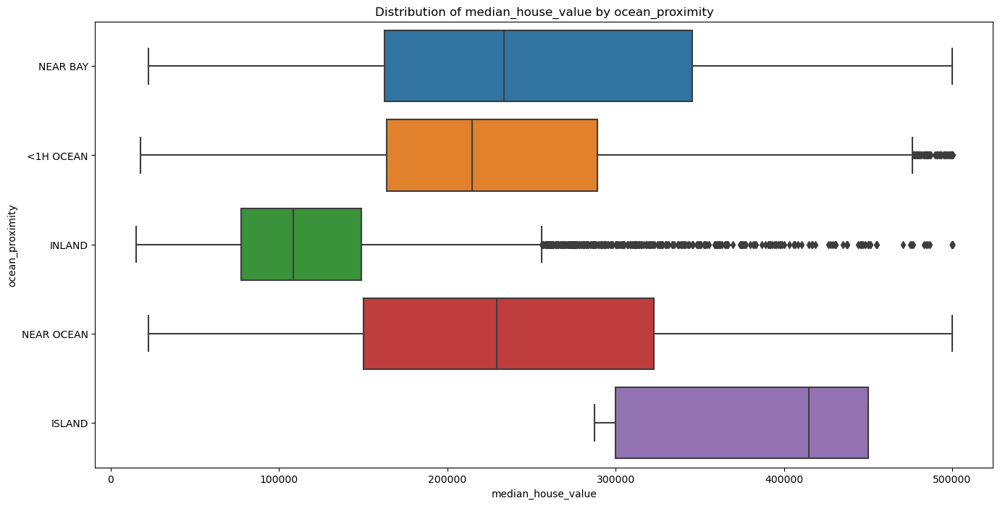

In [68]:
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)  # median_house_value  - стоимость недвижимости
                                                                            # ocean_proximity  - удалённость от океана 
plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

##### Как строится box plot

##### Подробное объяснение

- box - от 25% до 75% квантиля
- линия в середине box - медиана
- "усы"

##### Как строятся "усы" - вариантов масса

- среднее +/- 3 сигма (стандартное отклонение)
- min / max
- median +/- 1.5*(q75 - q25),
- ...

*Интерквартильный размах = q75 - q25

#### Матрица корреляций

- Показывает линейную связь между переменными
- Изменяется от -1 до 1
- Корреляция - мера только линейной связи

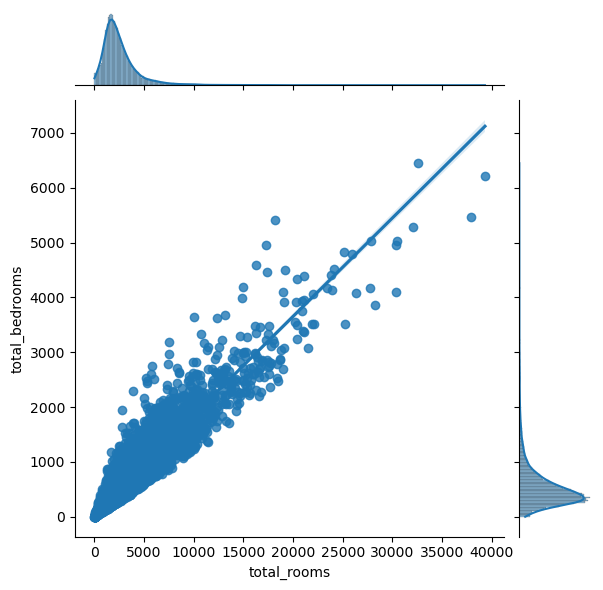

In [69]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

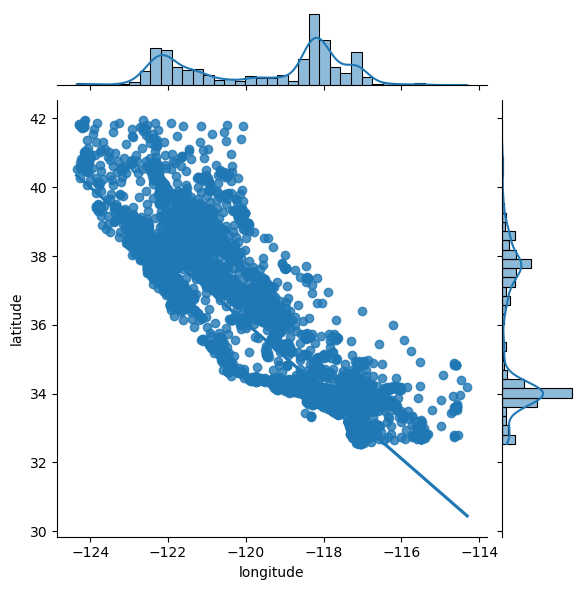

In [70]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');  # longitude - долгота,   latitude- широта

In [71]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0


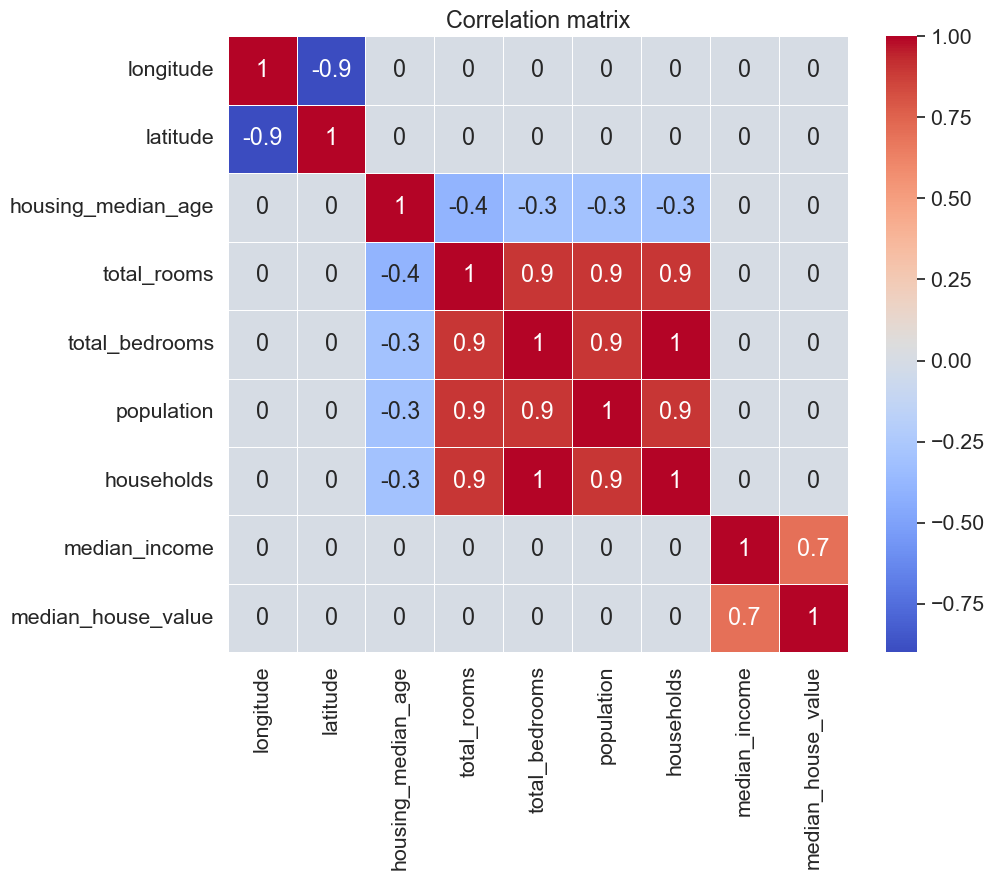

In [72]:
plt.figure(figsize=(10, 8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')    # heatmap -  тепловая карта

plt.title('Correlation matrix');

#### Гео данные

In [73]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05

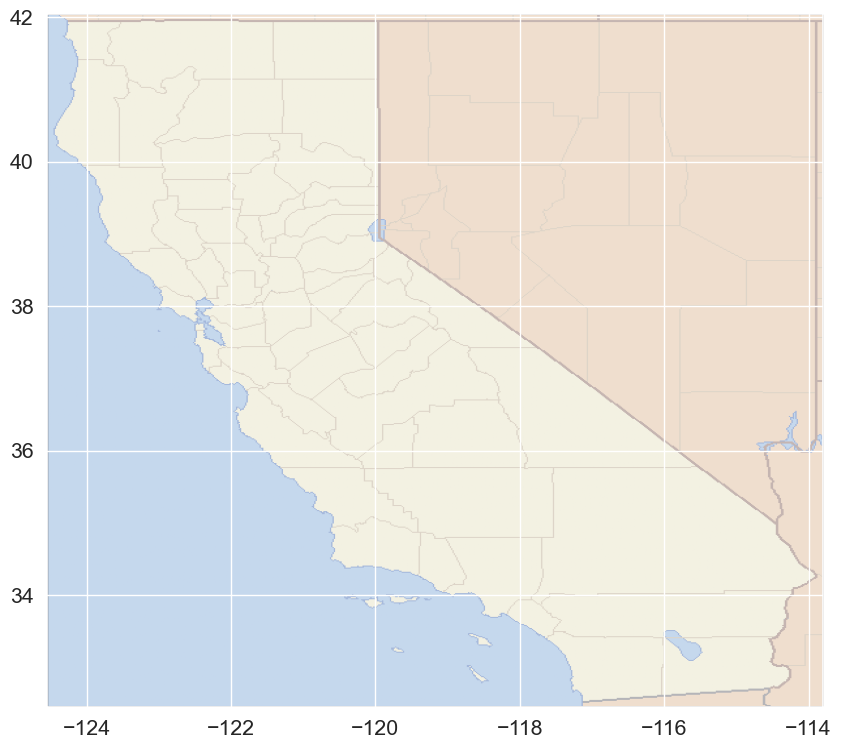

In [74]:
import matplotlib.image as img
california_map = img.imread('California_Map.png')

plt.figure(figsize=(12, 9))
plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

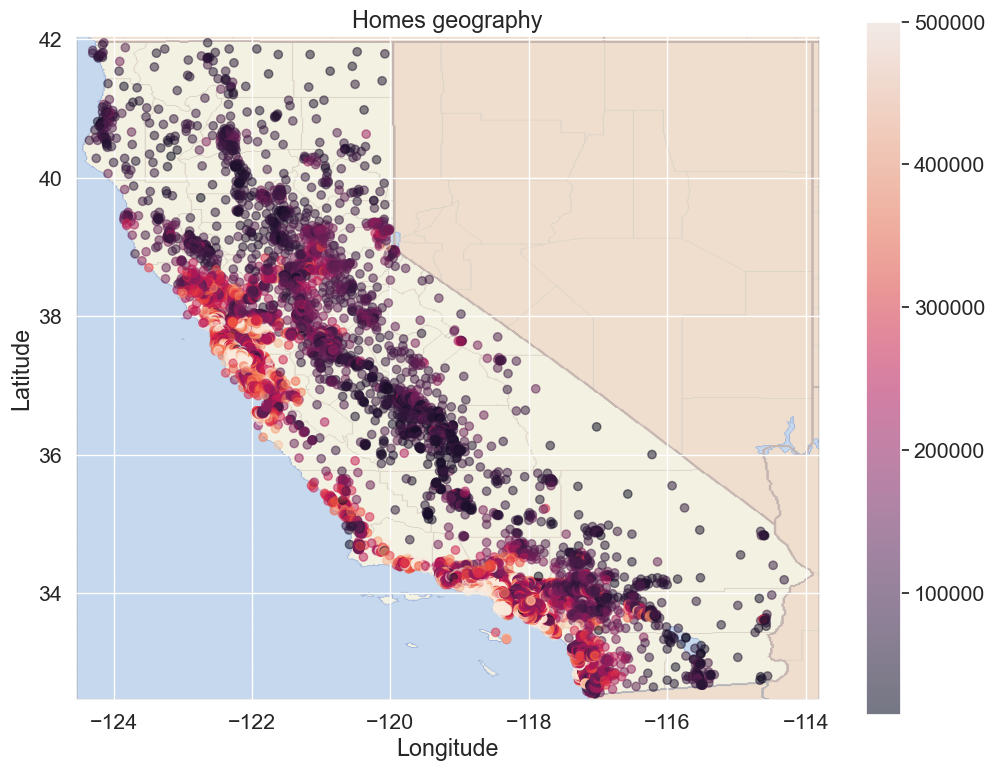

In [75]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

plt.imshow(california_map,
           extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Homes geography");

#### Folium

In [84]:
# !pip install folium

In [85]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

### Kepler**

!conda install -c conda-forge keplergl

!pip install keplergl==0.1.1

In [87]:
from keplergl import KeplerGl 

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md
Map saved to ./california.html!


#### Summary

1. Матрица корреляции
2. Знакомство с признаками
- Плотность распределения (Узнать распределение признака  -  sns.distplot/sns.kdeplot/plt.hist)
- Узнать распределение признака   -   sns.violinplot
- Столбчатая диаграмма (Узнать распределение категориального признака  -  sns.barplot/plt.bar)
- Ящик с усами (Узнать диапазон значений  -  sns.boxplot/plt.boxplot)
- Взаимное изменение признаков  -  sns.jointplot
- Изобразить долю объектов от всего кол-ва  -  plt.pie
3. Поиск выбросов
- sns.distplot/sns.kdeplot/plt.hist - Искать хвосты слева и справа
- sns.boxplot - Всё, что выходит за пределы усов - выбросы

- Seaborn - https://seaborn.pydata.org/examples/index.html
- Matplotlib - https://matplotlib.org/3.1.0/gallery/index.html